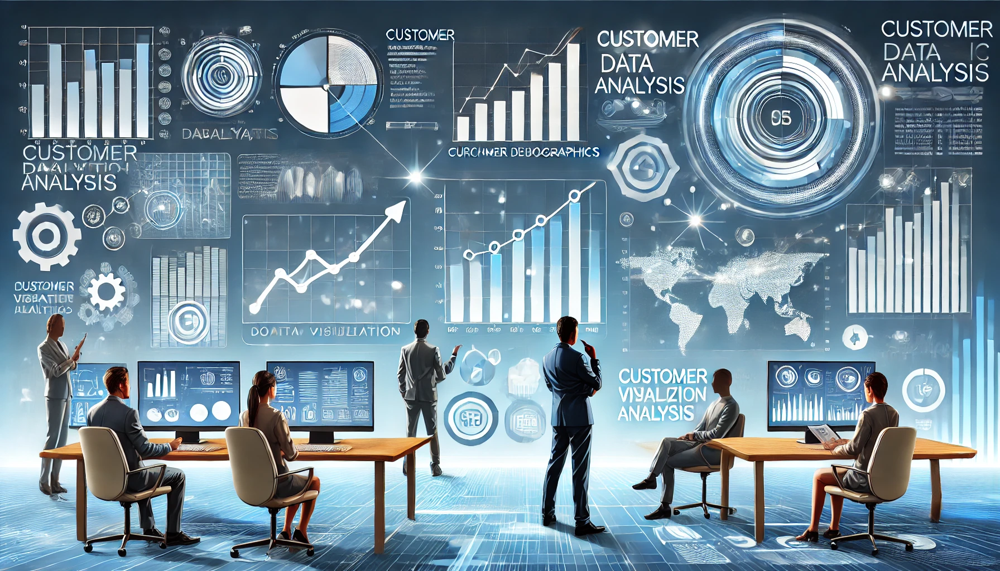

# 1. Install libraries

In [1]:
pip install ipywidgets

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install ipympl ipywidgets

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install --upgrade numba

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install ydata-profiling numba

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.6/38.6 MB 40.9 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.14.1
    Uninstalling scipy-1.14.1:
      Successfully uninstalled scipy-1.14.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cesium 0.12.3 requires numpy<3.0,>=2.0, but you have numpy 1.26.4 which is incompatible.
libpysal 4.9.2 requires packaging>=22, but you have packaging 21.3 which is incompatible.
libpysal 4.9.2 requires shapely>=2.0.1, but you have shapely 1.8.5.post1 which is incompatible.
mlxtend 0.23.3 requires scikit-learn>=1.3.1, but you have scikit-learn 1.2.2 which is incompatible.
plotnine 0.14.3 requires matplotlib>=3.8.0, but you have matplotlib 3.7.5 which is incompatible.
tsfresh 0.20.3 requires scipy>=1.14.0; pyth

In [5]:
pip install visions==0.7.6

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 2.6 MB/s eta 0:00:00
  Attempting uninstall: visions
    Found existing installation: visions 0.7.5
    Uninstalling visions-0.7.5:
      Successfully uninstalled visions-0.7.5
Note: you may need to restart the kernel to use updated packages.


In [6]:
pip install --upgrade visions

Note: you may need to restart the kernel to use updated packages.


In [7]:
pip install kneed

Note: you may need to restart the kernel to use updated packages.


# 2. Import libraries

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from sklearn import metrics
import warnings
from ydata_profiling import ProfileReport
warnings.filterwarnings('ignore')
import plotly.express as pe
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from kneed import KneeLocator
from sklearn.cluster import KMeans
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.cluster import DBSCAN
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
import itertools
from mpl_toolkits import mplot3d

# 3. Read dataset

In [9]:
train= pd.read_csv("/kaggle/input/customer-data/Customer_Data.csv")
train

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


# 4. Create Data Frame

In [10]:
df = pd.DataFrame(train)
df

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


# 5. Pre-Processing

## 5.1. Dataset information

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

## 5.2. Dataset statistics

In [12]:
df.describe().T.style.background_gradient(cmap='coolwarm', axis=1)

,count,mean,std,min,25%,50%,75%,max
BALANCE,8950.000000,1564.474828,2081.531879,0.000000,128.281915,873.385231,2054.140036,19043.138560
BALANCE_FREQUENCY,8950.000000,0.877271,0.236904,0.000000,0.888889,1.000000,1.000000,1.000000
PURCHASES,8950.000000,1003.204834,2136.634782,0.000000,39.635000,361.280000,1110.130000,49039.570000
ONEOFF_PURCHASES,8950.000000,592.437371,1659.887917,0.000000,0.000000,38.000000,577.405000,40761.250000
INSTALLMENTS_PURCHASES,8950.000000,411.067645,904.338115,0.000000,0.000000,89.000000,468.637500,22500.000000
CASH_ADVANCE,8950.000000,978.871112,2097.163877,0.000000,0.000000,0.000000,1113.821139,47137.211760
PURCHASES_FREQUENCY,8950.000000,0.490351,0.401371,0.000000,0.083333,0.500000,0.916667,1.000000
ONEOFF_PURCHASES_FREQUENCY,8950.000000,0.202458,0.298336,0.000000,0.000000,0.083333,0.300000,1.000000
PURCHASES_INSTALLMENTS_FREQUENCY,8950.000000,0.364437,0.397448,0.000000,0.000000,0.166667,0.750000,1.000000
CASH_ADVANCE_FREQUENCY,8950.000000,0.135144,0.200121,0.000000,0.000000,0.000000,0.222222,1.500000


## 5.3. Check hidden characters in column's name

In [13]:
for col in df.columns:
    print(repr(col))

'CUST_ID'
'BALANCE'
'BALANCE_FREQUENCY'
'PURCHASES'
'ONEOFF_PURCHASES'
'INSTALLMENTS_PURCHASES'
'CASH_ADVANCE'
'PURCHASES_FREQUENCY'
'ONEOFF_PURCHASES_FREQUENCY'
'PURCHASES_INSTALLMENTS_FREQUENCY'
'CASH_ADVANCE_FREQUENCY'
'CASH_ADVANCE_TRX'
'PURCHASES_TRX'
'CREDIT_LIMIT'
'PAYMENTS'
'MINIMUM_PAYMENTS'
'PRC_FULL_PAYMENT'
'TENURE'


## 5.4. Check duplicates

In [14]:
duplicates = df.duplicated()
if duplicates.any():
    print ("Duplicates exist")
else:
    print("Duplicates do not exist")

Duplicates do not exist


## 5.5. Check number of unique values

In [15]:
df.nunique()

CUST_ID                             8950
BALANCE                             8871
BALANCE_FREQUENCY                     43
PURCHASES                           6203
ONEOFF_PURCHASES                    4014
INSTALLMENTS_PURCHASES              4452
CASH_ADVANCE                        4323
PURCHASES_FREQUENCY                   47
ONEOFF_PURCHASES_FREQUENCY            47
PURCHASES_INSTALLMENTS_FREQUENCY      47
CASH_ADVANCE_FREQUENCY                54
CASH_ADVANCE_TRX                      65
PURCHASES_TRX                        173
CREDIT_LIMIT                         205
PAYMENTS                            8711
MINIMUM_PAYMENTS                    8636
PRC_FULL_PAYMENT                      47
TENURE                                 7
dtype: int64

## 5.6. Check missing values

In [16]:
df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [17]:
df['MINIMUM_PAYMENTS']

0        139.509787
1       1072.340217
2        627.284787
3               NaN
4        244.791237
           ...     
8945      48.886365
8946            NaN
8947      82.418369
8948      55.755628
8949      88.288956
Name: MINIMUM_PAYMENTS, Length: 8950, dtype: float64

In [18]:
df[df.isna().any(axis=1)]

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.0,12
45,C10047,2242.311686,1.000000,437.00,97.00,340.0,184.648692,0.333333,0.083333,0.333333,0.166667,2,5,2400.0,0.000000,NaN,0.0,12
47,C10049,3910.111237,1.000000,0.00,0.00,0.0,1980.873201,0.000000,0.000000,0.000000,0.500000,7,0,4200.0,0.000000,NaN,0.0,12
54,C10056,6.660517,0.636364,310.00,0.00,310.0,0.000000,0.666667,0.000000,0.666667,0.000000,0,8,1000.0,417.016763,NaN,0.0,12
55,C10057,1311.995984,1.000000,1283.90,1283.90,0.0,0.000000,0.250000,0.250000,0.000000,0.000000,0,6,6000.0,0.000000,NaN,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8919,C19160,14.524779,0.333333,152.00,152.00,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,1500.0,0.000000,NaN,0.0,6
8929,C19170,371.527312,0.333333,0.00,0.00,0.0,1465.407927,0.000000,0.000000,0.000000,0.166667,5,0,1500.0,0.000000,NaN,0.0,6
8935,C19176,183.817004,1.000000,465.90,0.00,465.9,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1500.0,0.000000,NaN,0.0,6
8944,C19185,193.571722,0.833333,1012.73,1012.73,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,4000.0,0.000000,NaN,0.0,6


## 5.7. Check data type

In [19]:
df.dtypes

CUST_ID                              object
BALANCE                             float64
BALANCE_FREQUENCY                   float64
PURCHASES                           float64
ONEOFF_PURCHASES                    float64
INSTALLMENTS_PURCHASES              float64
CASH_ADVANCE                        float64
PURCHASES_FREQUENCY                 float64
ONEOFF_PURCHASES_FREQUENCY          float64
PURCHASES_INSTALLMENTS_FREQUENCY    float64
CASH_ADVANCE_FREQUENCY              float64
CASH_ADVANCE_TRX                      int64
PURCHASES_TRX                         int64
CREDIT_LIMIT                        float64
PAYMENTS                            float64
MINIMUM_PAYMENTS                    float64
PRC_FULL_PAYMENT                    float64
TENURE                                int64
dtype: object

## 5.8. Drop CUST_ID column 

In [20]:
df1 = df.drop("CUST_ID", axis=1)

## 5.9. Check negative values

In [21]:
negative_values = (df1 < 0).sum()
negative_values

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

## 5.10. Data report

In [22]:
profile_report = ProfileReport(df)
profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 5.11. New dataset after dropping missing values

In [23]:
df2 = df1.dropna()

## 5.12. New dataset statistics

In [24]:
df2.describe().T.style.background_gradient(cmap='coolwarm', axis=1)

,count,mean,std,min,25%,50%,75%,max
BALANCE,8636.000000,1601.224893,2095.571300,0.000000,148.095189,916.855459,2105.195853,19043.138560
BALANCE_FREQUENCY,8636.000000,0.895035,0.207697,0.000000,0.909091,1.000000,1.000000,1.000000
PURCHASES,8636.000000,1025.433874,2167.107984,0.000000,43.367500,375.405000,1145.980000,49039.570000
ONEOFF_PURCHASES,8636.000000,604.901438,1684.307803,0.000000,0.000000,44.995000,599.100000,40761.250000
INSTALLMENTS_PURCHASES,8636.000000,420.843533,917.245182,0.000000,0.000000,94.785000,484.147500,22500.000000
CASH_ADVANCE,8636.000000,994.175523,2121.458303,0.000000,0.000000,0.000000,1132.385490,47137.211760
PURCHASES_FREQUENCY,8636.000000,0.496000,0.401273,0.000000,0.083333,0.500000,0.916667,1.000000
ONEOFF_PURCHASES_FREQUENCY,8636.000000,0.205909,0.300054,0.000000,0.000000,0.083333,0.333333,1.000000
PURCHASES_INSTALLMENTS_FREQUENCY,8636.000000,0.368820,0.398093,0.000000,0.000000,0.166667,0.750000,1.000000
CASH_ADVANCE_FREQUENCY,8636.000000,0.137604,0.201791,0.000000,0.000000,0.000000,0.250000,1.500000


## 5.13. New dataset unique values

In [25]:
df2.nunique()

BALANCE                             8631
BALANCE_FREQUENCY                     42
PURCHASES                           6015
ONEOFF_PURCHASES                    3922
INSTALLMENTS_PURCHASES              4341
CASH_ADVANCE                        4206
PURCHASES_FREQUENCY                   47
ONEOFF_PURCHASES_FREQUENCY            47
PURCHASES_INSTALLMENTS_FREQUENCY      47
CASH_ADVANCE_FREQUENCY                54
CASH_ADVANCE_TRX                      65
PURCHASES_TRX                        173
CREDIT_LIMIT                         203
PAYMENTS                            8636
MINIMUM_PAYMENTS                    8635
PRC_FULL_PAYMENT                      47
TENURE                                 7
dtype: int64

# 7. Visualization

## 7.1. Heatmap plot

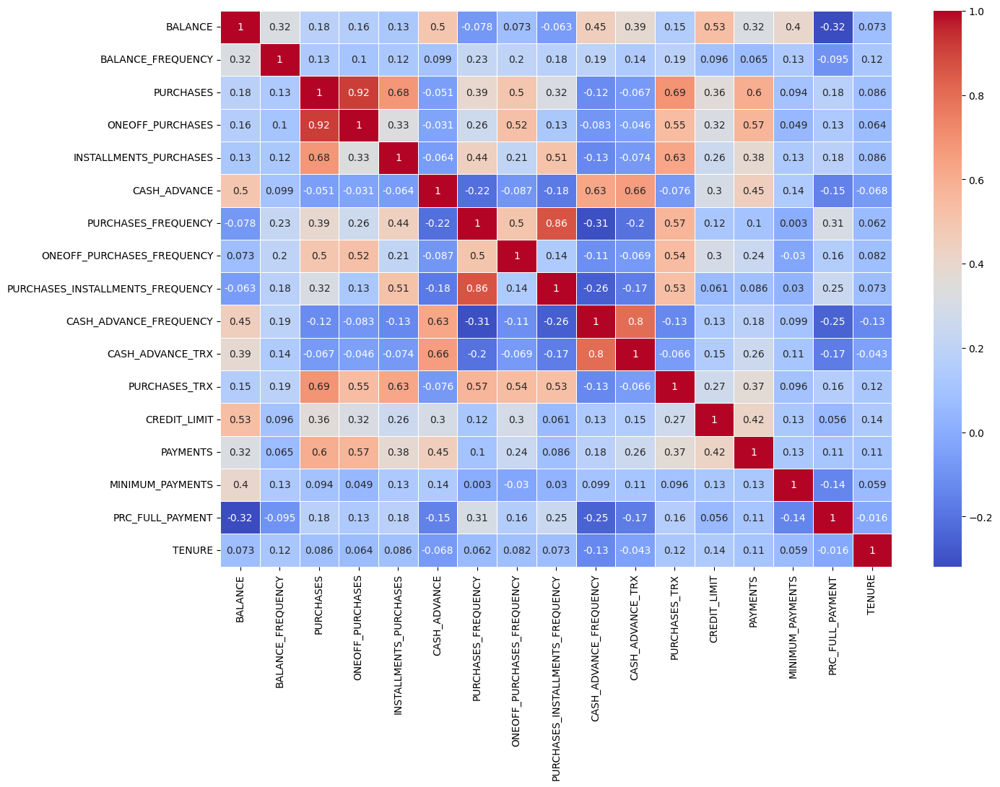

In [26]:
%matplotlib inline
b,c=plt.subplots(figsize=(15,10))
sns.heatmap(df1.corr(),cmap='coolwarm',cbar=True,annot=True,linewidths=0.5,ax=c)
plt.show()

## 7.2. Bar Chart

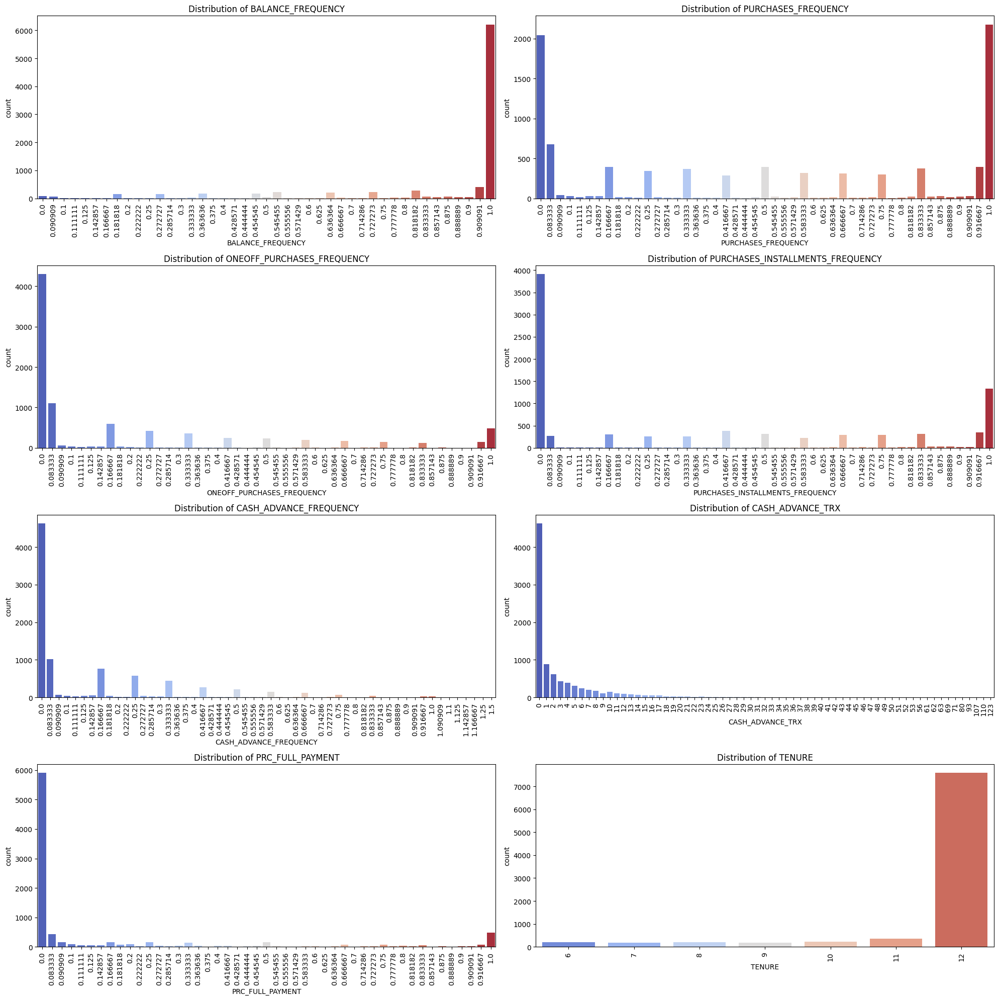

In [27]:
col = ['BALANCE_FREQUENCY', 'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PRC_FULL_PAYMENT', 'TENURE']

# Create subplots
fig, axes = plt.subplots(4, 2, figsize=(20, 20))

for idx, col in enumerate(col):
    row = idx // 2  # Determine the row number
    col_pos = idx % 2  # Determine the column number
    
    # Use histplot for numerical data
    sns.countplot(data=df, x=col,  palette='coolwarm', ax=axes[row, col_pos])

    # Set title for each subplot
    axes[row, col_pos].set_title(f'Distribution of {col}')

    axes[row, col_pos].tick_params(axis='x', rotation=90)


# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

In [28]:
column = ['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS']

## 7.3. 3D Scatter Plot of Balance Frequency, Purchases and Balance

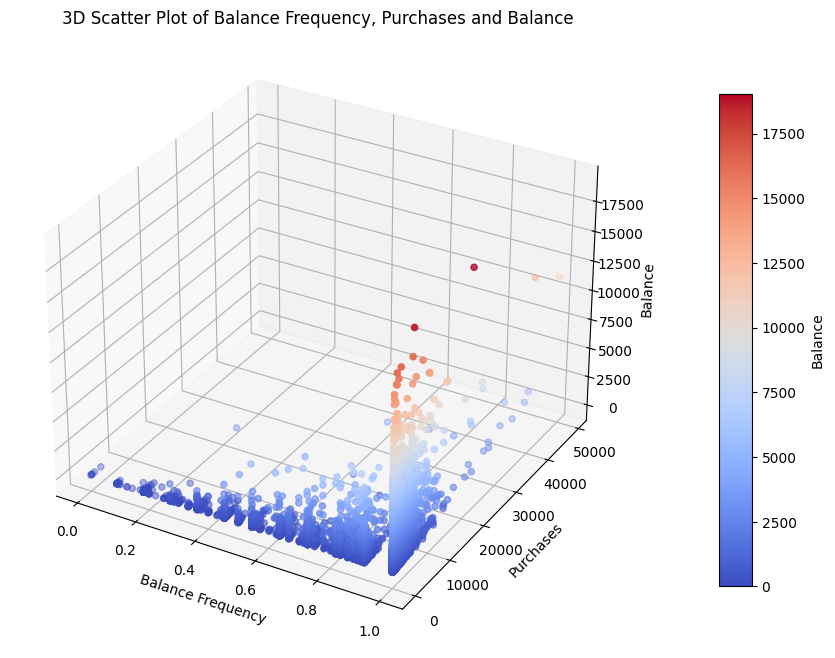

In [29]:
%matplotlib inline

fig = plt.figure(figsize=(12, 8))


# Set up 3D projection
ax = plt.axes(projection='3d')

# Define axis data
x = df2['BALANCE_FREQUENCY']
y = df2['PURCHASES']
z = df2['BALANCE']

# Plotting a scatter plot for better visualization of individual points
scatter = ax.scatter3D(x, y, z, c=z, cmap='coolwarm', marker='o')

# Adding labels
ax.set_xlabel('Balance Frequency')
ax.set_ylabel('Purchases')
ax.set_zlabel('Balance')

# ax.view_init(45, 215)

# Adding a color bar for scale reference
fig.colorbar(scatter, ax=ax, label='Balance', shrink=0.8, aspect=15, pad=0.1)

# Setting title
ax.set_title('3D Scatter Plot of Balance Frequency, Purchases and Balance')

plt.show()


## 7.4. 3D Scatter Plot of Credit limit, Purchases and Balance

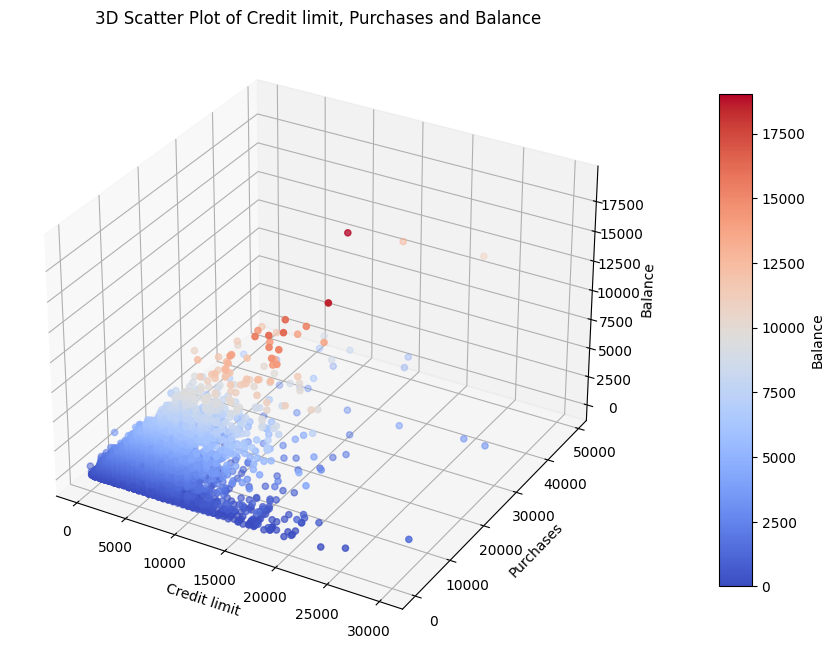

In [30]:
%matplotlib inline

fig = plt.figure(figsize=(12, 8))


# Set up 3D projection
ax = plt.axes(projection='3d')

# Define axis data
x = df2['CREDIT_LIMIT']
y = df2['PURCHASES']
z = df2['BALANCE']

# Plotting a scatter plot for better visualization of individual points
scatter = ax.scatter3D(x, y, z, c=z, cmap='coolwarm', marker='o')

# Adding labels
ax.set_xlabel('Credit limit')
ax.set_ylabel('Purchases')
ax.set_zlabel('Balance')

# ax.view_init(45, 215)

# Adding a color bar for scale reference
fig.colorbar(scatter, ax=ax, label='Balance', shrink=0.8, aspect=15, pad=0.1)

# Setting title
ax.set_title('3D Scatter Plot of Credit limit, Purchases and Balance')

plt.show()


## 7.5. 3D Scatter Plot of Credit limit, Payments and Balance

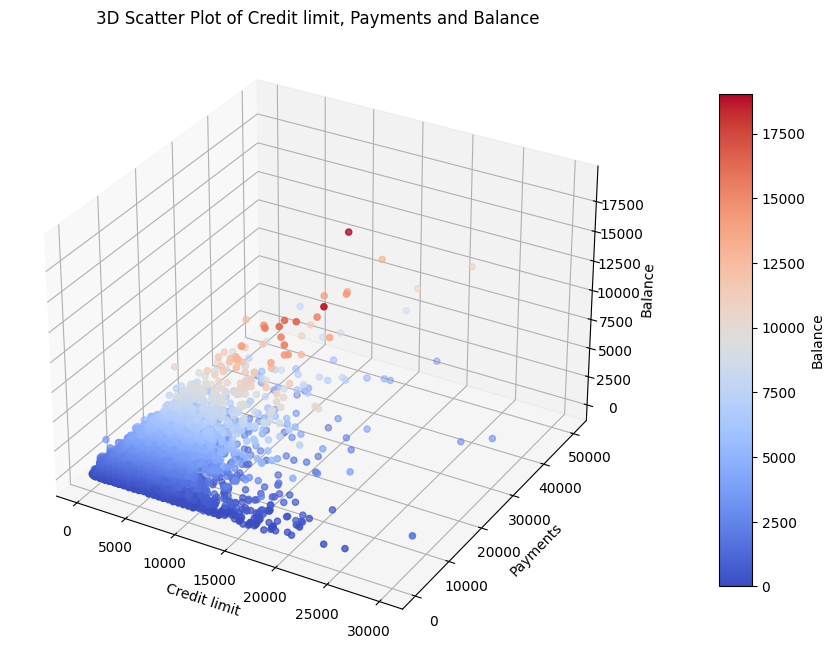

In [31]:
%matplotlib inline

fig = plt.figure(figsize=(12, 8))


# Set up 3D projection
ax = plt.axes(projection='3d')

# Define axis data
x = df2['CREDIT_LIMIT']
y = df2['PAYMENTS']
z = df2['BALANCE']

# Plotting a scatter plot for better visualization of individual points
scatter = ax.scatter3D(x, y, z, c=z, cmap='coolwarm', marker='o')

# Adding labels
ax.set_xlabel('Credit limit')
ax.set_ylabel('Payments')
ax.set_zlabel('Balance')

# ax.view_init(45, 215)

# Adding a color bar for scale reference
fig.colorbar(scatter, ax=ax, label='Balance', shrink=0.8, aspect=15, pad=0.1)

# Setting title
ax.set_title('3D Scatter Plot of Credit limit, Payments and Balance')

plt.show()


## 7.6. 3D Scatter Plot of Purchase, Minimum payment and Balance

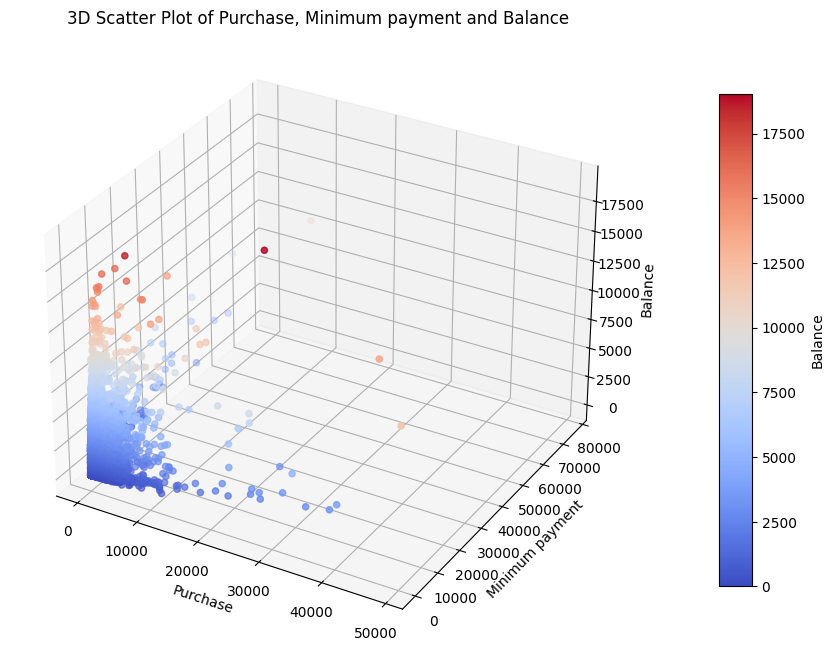

In [32]:
%matplotlib inline

fig = plt.figure(figsize=(12, 8))


# Set up 3D projection
ax = plt.axes(projection='3d')

# Define axis data

x = df2['PURCHASES']
y = df2['MINIMUM_PAYMENTS']
z = df2['BALANCE']

# Plotting a scatter plot for better visualization of individual points
scatter = ax.scatter3D(x, y, z, c=z, cmap='coolwarm', marker='o')

# Adding labels
ax.set_xlabel('Purchase')
ax.set_ylabel('Minimum payment')
ax.set_zlabel('Balance')

# ax.view_init(45, 215)

# Adding a color bar for scale reference
fig.colorbar(scatter, ax=ax, label='Balance', shrink=0.8, aspect=15, pad=0.1)

# Setting title
ax.set_title('3D Scatter Plot of Purchase, Minimum payment and Balance')

plt.show()


## 7.7. 3D Scatter Plot of Purchase, Payment and Balance

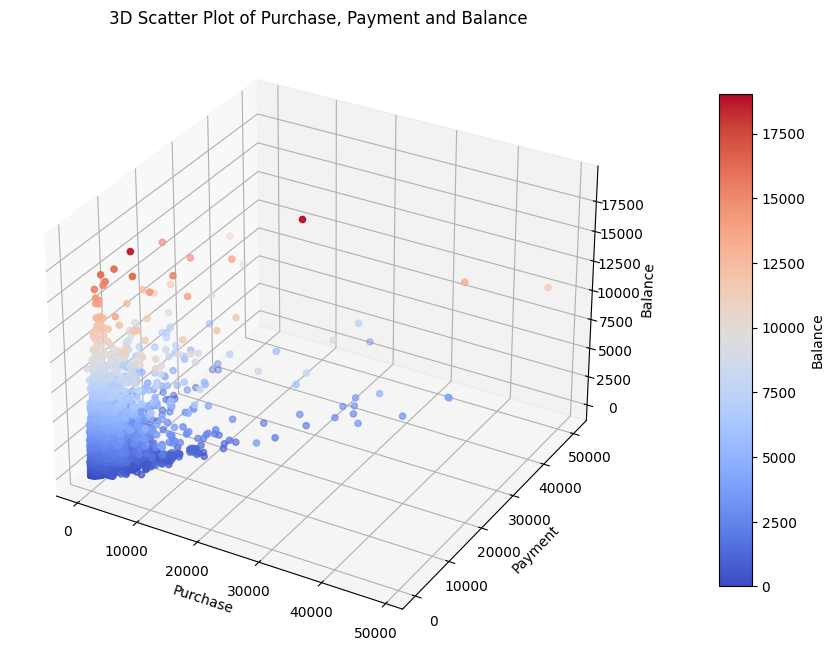

In [33]:
%matplotlib inline

fig = plt.figure(figsize=(12, 8))


# Set up 3D projection
ax = plt.axes(projection='3d')

# Define axis data

x = df2['PURCHASES']
y = df2['PAYMENTS']
z = df2['BALANCE']

# Plotting a scatter plot for better visualization of individual points
scatter = ax.scatter3D(x, y, z, c=z, cmap='coolwarm', marker='o')

# Adding labels
ax.set_xlabel('Purchase')
ax.set_ylabel('Payment')
ax.set_zlabel('Balance')

#ax.view_init(45, 225)

# Adding a color bar for scale reference
fig.colorbar(scatter, ax=ax, label='Balance', shrink=0.8, aspect=15, pad=0.1)

# Setting title
ax.set_title('3D Scatter Plot of Purchase, Payment and Balance')

plt.show()


## 7.8. 3D Scatter Plot of Purchase Frequency, Credit limit and Payment

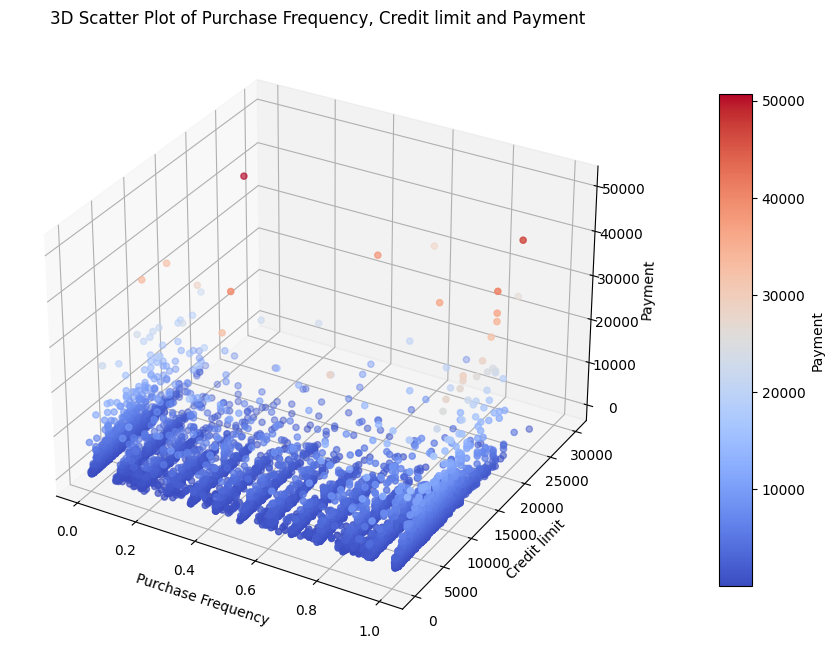

In [34]:
%matplotlib inline

fig = plt.figure(figsize=(12, 8))


# Set up 3D projection
ax = plt.axes(projection='3d')

# Define axis data

x = df2['PURCHASES_FREQUENCY']
y = df2['CREDIT_LIMIT']
z = df2['PAYMENTS']

# Plotting a scatter plot for better visualization of individual points
scatter = ax.scatter3D(x, y, z, c=z, cmap='coolwarm', marker='o')

# Adding labels
ax.set_xlabel('Purchase Frequency')
ax.set_ylabel('Credit limit')
ax.set_zlabel('Payment')

#ax.view_init(45, 225)

# Adding a color bar for scale reference
fig.colorbar(scatter, ax=ax, label='Payment', shrink=0.8, aspect=15, pad=0.1)

# Setting title
ax.set_title('3D Scatter Plot of Purchase Frequency, Credit limit and Payment')

plt.show()


# 8. Normalizing Dataset

In [35]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df2)

# 9. Algorithm's Analysis

## 9.1. KMeans clustering

In [36]:
List = []

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, init='random', n_init=10, max_iter=300, random_state=42)
    kmeans.fit(scaled_features)
    List.append(kmeans.inertia_)

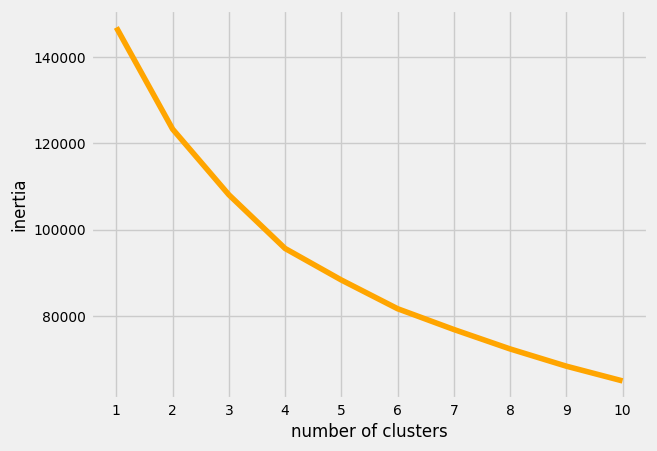

In [37]:
plt.style.use('fivethirtyeight')
plt.plot(range(1,11),List , color= "orange")
plt.xticks(range(1,11), fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('number of clusters', fontsize=12)
plt.ylabel('inertia', fontsize=12)
plt.show()

In [38]:
kl = KneeLocator(range(1, 11), List, curve="convex", direction="decreasing")
kl.elbow

4

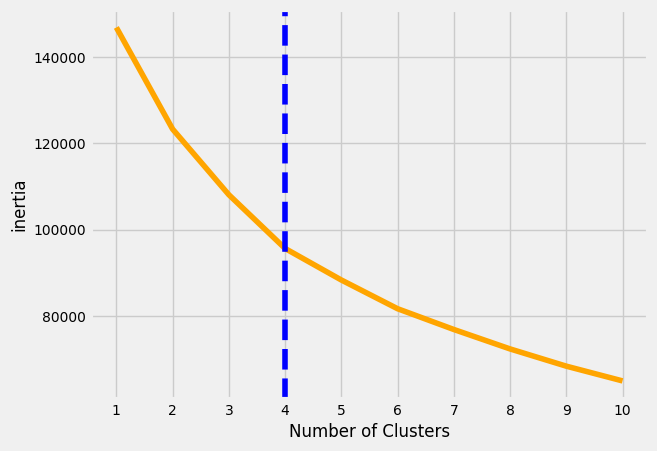

In [39]:
plt.style.use("fivethirtyeight")
plt.plot(range(1, 11), List , color= "orange")

plt.xticks(range(1, 11), fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel("Number of Clusters", fontsize=12)

plt.ylabel("inertia", fontsize=12)
plt.axvline(x=kl.elbow, color='b', label='axvline full height', ls='--')

plt.show()

In [40]:
kmeans = KMeans(n_clusters=3).fit(df2)
centroids = kmeans.cluster_centers_
print(centroids)

[[8.77311130e+02 8.76089908e-01 6.18318125e+02 3.20230705e+02
  2.98399159e+02 5.00039663e+02 4.73544221e-01 1.57283798e-01
  3.56502839e-01 1.08871159e-01 2.29515278e+00 1.09123340e+01
  2.74217303e+03 1.03554727e+03 5.72756589e+02 1.64029923e-01
  1.14535274e+01]
 [3.41976698e+03 9.46465639e-01 1.59411484e+03 9.92002336e+02
  6.02430426e+02 2.10377181e+03 5.43785667e-01 3.18394278e-01
  3.89511837e-01 2.11854387e-01 5.79085258e+00 2.23743339e+01
  8.99218674e+03 2.91121948e+03 1.57850101e+03 1.36147379e-01
  1.17406750e+01]
 [4.83301557e+03 9.14620970e-01 1.05307798e+04 7.42990541e+03
  3.10103977e+03 5.43050951e+03 7.42298917e-01 5.86638699e-01
  5.97387970e-01 2.30828677e-01 9.25563910e+00 8.44135338e+01
  1.24890977e+04 1.79058694e+04 2.47407345e+03 3.29256820e-01
  1.18421053e+01]]


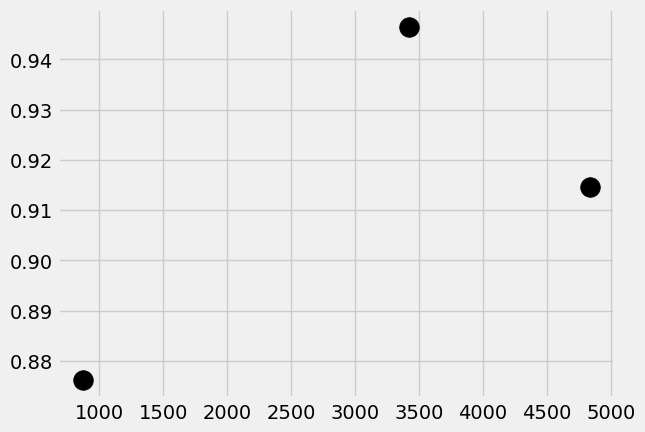

In [41]:
plt.scatter(centroids[:, 0], centroids[:, 1], c='black', s=200, alpha= 1)
plt.show()

### 9.1.1. Internal validation:

#### 9.1.1.1. Silhouette Coefficient

In [42]:
silhouette_coefficients = []

for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, init='random', n_init=10, max_iter=300, random_state=42)
    kmeans.fit(scaled_features)
    score = silhouette_score(scaled_features, kmeans.labels_)
    silhouette_coefficients.append(score)

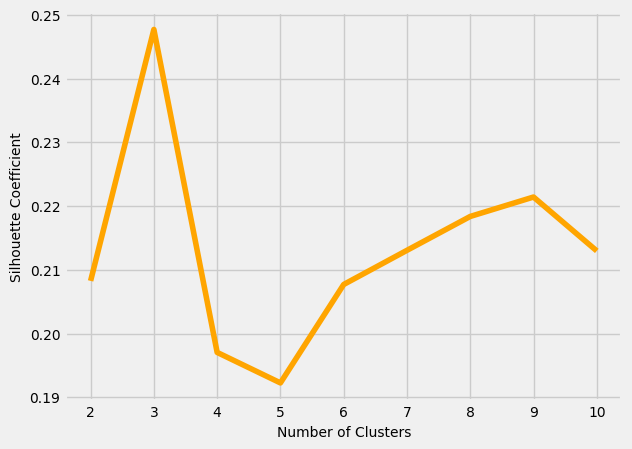

In [43]:
plt.style.use("fivethirtyeight")
plt.plot(range(2, 11), silhouette_coefficients, color= "orange")
plt.xticks(range(2, 11), fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel("Number of Clusters", fontsize=10)
plt.ylabel("Silhouette Coefficient" , fontsize=10)
plt.show()

#### Tuning hyperparameters

In [44]:
init =  ['k-means++', 'random']
n_init = [1 ,20]
algorithm = ["lloyd", "elkan"]
nclusters = range(2,11)

silhouette_coefficients = []

# Iterate over all combinations of parameters
for i in init:
    for n in n_init:
        for a in algorithm:
            for k in nclusters:
                kmeans = KMeans(n_clusters=k, init=i, n_init=n, algorithm=a, max_iter=300, random_state=42)
                kmeans.fit(scaled_features)
                
                # Calculate the silhouette score
                score = silhouette_score(scaled_features, kmeans.labels_)
                silhouette_coefficients.append((k, i, n, a, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_df = pd.DataFrame(silhouette_coefficients, columns=['n_clusters', 'init', 'n_init', 'algorithm', 'silhouette_score'])
results_df

,n_clusters,init,n_init,algorithm,silhouette_score
0,2,k-means++,1,lloyd,0.280214
1,3,k-means++,1,lloyd,0.247546
2,4,k-means++,1,lloyd,0.169371
3,5,k-means++,1,lloyd,0.196780
4,6,k-means++,1,lloyd,0.208601
...,...,...,...,...,...
67,6,random,20,elkan,0.207697
68,7,random,20,elkan,0.220254
69,8,random,20,elkan,0.223831
70,9,random,20,elkan,0.219473


In [45]:
max_index = results_df['silhouette_score'].idxmax()
max_row = results_df.loc[max_index]
max_row

n_clusters                  2
init                k-means++
n_init                      1
algorithm               lloyd
silhouette_score     0.280214
Name: 0, dtype: object

In [46]:
results_df.style.highlight_max(color = 'orange', axis = 0, subset= ['silhouette_score'])

,n_clusters,init,n_init,algorithm,silhouette_score
0,2,k-means++,1,lloyd,0.280214
1,3,k-means++,1,lloyd,0.247546
2,4,k-means++,1,lloyd,0.169371
3,5,k-means++,1,lloyd,0.196780
4,6,k-means++,1,lloyd,0.208601
5,7,k-means++,1,lloyd,0.219694
6,8,k-means++,1,lloyd,0.227367
7,9,k-means++,1,lloyd,0.231543
8,10,k-means++,1,lloyd,0.225057
9,2,k-means++,1,elkan,0.280214


In [47]:
max_value = results_df['silhouette_score'].max()
# Create a mask to extract all rows with the maximum value
max_rows_s = results_df[results_df['silhouette_score'] == max_value]
max_rows_s

,n_clusters,init,n_init,algorithm,silhouette_score
0,2,k-means++,1,lloyd,0.280214
9,2,k-means++,1,elkan,0.280214


# 

#### 9.1.1.2. Calinski harabasz

In [48]:
calinski_harabasz=[]

for k in range(2, 11):
    kmeans = KMeans(n_clusters = k, init='random', n_init=10, max_iter=300, random_state=42)
    kmeans.fit(scaled_features)
    score = calinski_harabasz_score(scaled_features, kmeans.labels_)
    calinski_harabasz.append(score)

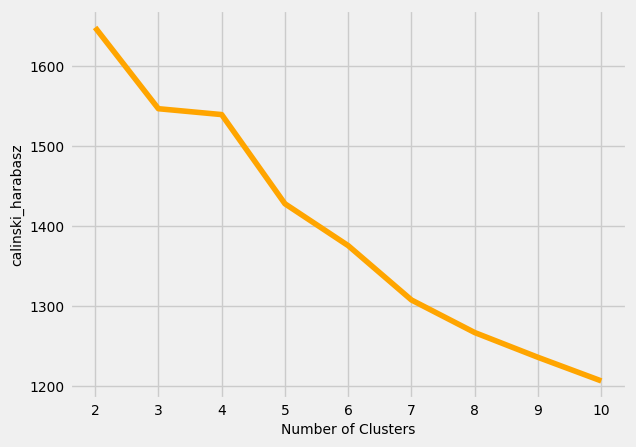

In [49]:
plt.style.use("fivethirtyeight")
plt.plot(range(2, 11), calinski_harabasz, color= "orange")
plt.xticks(range(2, 11), fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel("Number of Clusters", fontsize=10)
plt.ylabel("calinski_harabasz" , fontsize=10)
plt.show()

#### Tuning hyperparameters

In [50]:
init =  ['k-means++', 'random']
n_init = [1 ,20]
algorithm = ["lloyd", "elkan"]
nclusters = range(2,11)

calinski_harabasz = []

# Iterate over all combinations of parameters
for i in init:
    for n in n_init:
        for a in algorithm:
            for k in nclusters:
                kmeans = KMeans(n_clusters=k, init=i, n_init=n, algorithm=a, max_iter=300, random_state=42)
                kmeans.fit(scaled_features)
                
                # Calculate the silhouette score
                score = calinski_harabasz_score(scaled_features, kmeans.labels_)
                calinski_harabasz.append((k, i, n, a, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_ch = pd.DataFrame(calinski_harabasz, columns=['n_clusters', 'init', 'n_init', 'algorithm', 'calinski_harabasze'])
results_ch

,n_clusters,init,n_init,algorithm,calinski_harabasze
0,2,k-means++,1,lloyd,1546.773154
1,3,k-means++,1,lloyd,1546.534902
2,4,k-means++,1,lloyd,1327.371195
3,5,k-means++,1,lloyd,1411.090788
4,6,k-means++,1,lloyd,1323.417946
...,...,...,...,...,...
67,6,random,20,elkan,1375.681139
68,7,random,20,elkan,1323.930677
69,8,random,20,elkan,1284.564795
70,9,random,20,elkan,1240.663019


In [51]:
max_index = results_ch['calinski_harabasze'].idxmax()
max_row = results_ch.loc[max_index]
max_row

n_clusters                      2
init                    k-means++
n_init                         20
algorithm                   lloyd
calinski_harabasze    1647.930702
Name: 18, dtype: object

In [52]:
results_ch.style.highlight_max(color = 'orange', axis = 0, subset= ['calinski_harabasze'])

,n_clusters,init,n_init,algorithm,calinski_harabasze
0,2,k-means++,1,lloyd,1546.773154
1,3,k-means++,1,lloyd,1546.534902
2,4,k-means++,1,lloyd,1327.371195
3,5,k-means++,1,lloyd,1411.090788
4,6,k-means++,1,lloyd,1323.417946
5,7,k-means++,1,lloyd,1323.950798
6,8,k-means++,1,lloyd,1296.142744
7,9,k-means++,1,lloyd,1282.020337
8,10,k-means++,1,lloyd,1246.617900
9,2,k-means++,1,elkan,1546.773154


In [53]:
max_value = results_ch['calinski_harabasze'].max()
# Create a mask to extract all rows with the maximum value
max_rows_ch = results_ch[results_ch['calinski_harabasze'] == max_value]
max_rows_ch

,n_clusters,init,n_init,algorithm,calinski_harabasze
18,2,k-means++,20,lloyd,1647.930702
27,2,k-means++,20,elkan,1647.930702
54,2,random,20,lloyd,1647.930702
63,2,random,20,elkan,1647.930702


# 

#### 9.1.1.3. Davies Bouldin

In [54]:
Davies_Bouldin=[]

for k in range(2, 11):
    kmeans = KMeans(n_clusters = k, init='random', n_init=10, max_iter=300, random_state=42)
    kmeans.fit(scaled_features)
    score = davies_bouldin_score(scaled_features, kmeans.labels_)
    Davies_Bouldin.append(score)

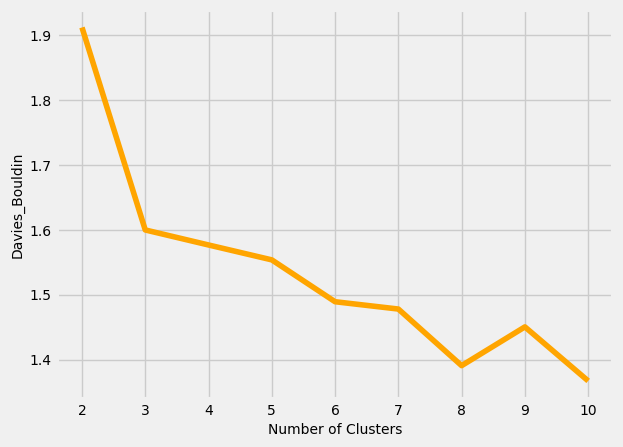

In [55]:
plt.style.use("fivethirtyeight")
plt.plot(range(2, 11), Davies_Bouldin, color= "orange")
plt.xticks(range(2, 11), fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel("Number of Clusters", fontsize=10)
plt.ylabel("Davies_Bouldin" , fontsize=10)
plt.show()

#### Tuning hyperparameters

In [56]:
init =  ['k-means++', 'random']
n_init = [1 ,20]
algorithm = ["lloyd", "elkan"]
nclusters = range(2,11)

Davies_bouldin = []

# Iterate over all combinations of parameters
for i in init:
    for n in n_init:
        for a in algorithm:
            for k in nclusters:
                kmeans = KMeans(n_clusters=k, init=i, n_init=n, algorithm = a, max_iter=300, random_state=42)
                kmeans.fit(scaled_features)
                
                # Calculate the silhouette score
                score = davies_bouldin_score(scaled_features, kmeans.labels_)
                Davies_bouldin.append((k, i, n, a, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_db = pd.DataFrame(Davies_bouldin, columns=['n_clusters', 'init', 'n_init', 'algorithm', 'davies_bouldin'])
results_db

,n_clusters,init,n_init,algorithm,davies_bouldin
0,2,k-means++,1,lloyd,1.798141
1,3,k-means++,1,lloyd,1.604583
2,4,k-means++,1,lloyd,1.691196
3,5,k-means++,1,lloyd,1.447941
4,6,k-means++,1,lloyd,1.341897
...,...,...,...,...,...
67,6,random,20,elkan,1.489301
68,7,random,20,elkan,1.388119
69,8,random,20,elkan,1.301529
70,9,random,20,elkan,1.451477


In [57]:
max_index = results_db['davies_bouldin'].idxmax()
max_row = results_db.loc[max_index]
max_row

n_clusters                2
init              k-means++
n_init                   20
algorithm             lloyd
davies_bouldin     1.911714
Name: 18, dtype: object

In [58]:
results_db.style.highlight_max(color = 'orange', axis = 0, subset= ['davies_bouldin'])

,n_clusters,init,n_init,algorithm,davies_bouldin
0,2,k-means++,1,lloyd,1.798141
1,3,k-means++,1,lloyd,1.604583
2,4,k-means++,1,lloyd,1.691196
3,5,k-means++,1,lloyd,1.447941
4,6,k-means++,1,lloyd,1.341897
5,7,k-means++,1,lloyd,1.389566
6,8,k-means++,1,lloyd,1.359148
7,9,k-means++,1,lloyd,1.281251
8,10,k-means++,1,lloyd,1.356731
9,2,k-means++,1,elkan,1.798141


In [59]:
max_value = results_db['davies_bouldin'].max()
# Create a mask to extract all rows with the maximum value
max_rows_db = results_db[results_db['davies_bouldin'] == max_value]
max_rows_db

,n_clusters,init,n_init,algorithm,davies_bouldin
18,2,k-means++,20,lloyd,1.911714
27,2,k-means++,20,elkan,1.911714
54,2,random,20,lloyd,1.911714
63,2,random,20,elkan,1.911714


### 9.1.2. Final Results from KMeans

In [60]:
table = pd.concat([max_rows_s, max_rows_ch, max_rows_db], ignore_index=True)
table = table.fillna("-")
table

,n_clusters,init,n_init,algorithm,silhouette_score,calinski_harabasze,davies_bouldin
0,2,k-means++,1,lloyd,0.280214,-,-
1,2,k-means++,1,elkan,0.280214,-,-
2,2,k-means++,20,lloyd,-,1647.930702,-
3,2,k-means++,20,elkan,-,1647.930702,-
4,2,random,20,lloyd,-,1647.930702,-
5,2,random,20,elkan,-,1647.930702,-
6,2,k-means++,20,lloyd,-,-,1.911714
7,2,k-means++,20,elkan,-,-,1.911714
8,2,random,20,lloyd,-,-,1.911714
9,2,random,20,elkan,-,-,1.911714


### 9.1.3. Substituting the optimal parameters in KMeans and Prediction

In [61]:
kmeans = KMeans(n_clusters=2, init="random", n_init=20, algorithm = "lloyd" , max_iter=300, random_state=42)
kmeans.fit(scaled_features)
predict_k=kmeans.predict(scaled_features)

In [62]:
print("silhouette_score:", silhouette_score(scaled_features,kmeans.labels_))
print("calinski_harabasz:", calinski_harabasz_score(scaled_features,kmeans.labels_))
print("davies_bouldin:", davies_bouldin_score(scaled_features,kmeans.labels_))   

silhouette_score: 0.20892328220228673
calinski_harabasz: 1647.9307017211006
davies_bouldin: 1.911713851754164


### 9.1.4. Add KMean Prediction to dataset

In [63]:
df2['K_mean Prediction'] = predict_k
df3 = df2
df3

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,K_mean Prediction
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,1
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1
5,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8943,5.871712,0.500000,20.90,20.90,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,1,500.0,58.644883,43.473717,0.000000,6,1
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,1
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,1


## 9.2. Mini Batch KMeans

In [64]:
List = []

for k in range(1, 11):
    Minikmeans = MiniBatchKMeans(n_clusters=k, init='random', n_init=10, max_iter=300, random_state=42)
    Minikmeans.fit(scaled_features)
    List.append(Minikmeans.inertia_)

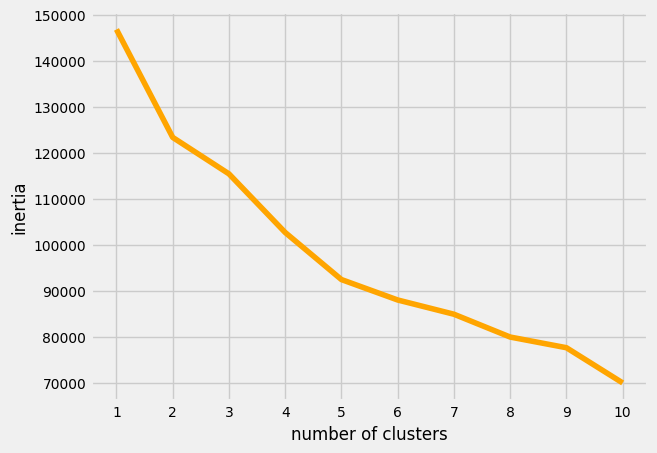

In [65]:
plt.style.use('fivethirtyeight')
plt.plot(range(1,11), List , color= "orange")
plt.xticks(range(1,11), fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel('number of clusters', fontsize=12)
plt.ylabel('inertia', fontsize=12)
plt.show()

In [66]:
kl = KneeLocator(range(1, 11), List, curve="convex", direction="decreasing")
kl.elbow

5

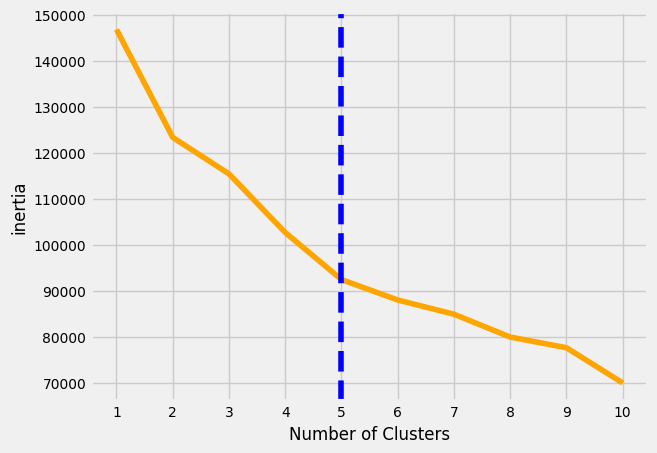

In [67]:
plt.style.use("fivethirtyeight")
plt.plot(range(1, 11), List , color= "orange")

plt.xticks(range(1, 11), fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel("Number of Clusters", fontsize=12)

plt.ylabel("inertia", fontsize=12)
plt.axvline(x=kl.elbow, color='b', label='axvline full height', ls='--')

plt.show()

In [68]:
Minikmeans = MiniBatchKMeans(n_clusters=3).fit(df2)
centroids = Minikmeans.cluster_centers_
print(centroids)

[[4.12615221e+03 9.50164329e-01 2.35896416e+03 1.53761007e+03
  8.21615715e+02 2.83147697e+03 5.49274070e-01 3.34610490e-01
  4.03225959e-01 2.43882772e-01 7.00073341e+00 2.83914558e+01
  9.77298730e+03 4.45893613e+03 2.02199613e+03 1.34240722e-01
  1.17086542e+01 5.04033737e-01]
 [1.20988514e+03 8.86133618e-01 1.02928771e+03 5.86568877e+02
  4.43283038e+02 6.96175439e+02 5.46090590e-01 2.54645152e-01
  3.93713263e-01 1.12787994e-01 2.54122433e+00 1.62573668e+01
  4.83349767e+03 1.52286226e+03 5.46585729e+02 1.95094154e-01
  1.16985812e+01 5.19495982e-01]
 [7.48594584e+02 8.81582893e-01 3.78236047e+02 1.67941515e+02
  2.10479000e+02 3.75732100e+02 4.24894972e-01 1.05380317e-01
  3.27930138e-01 1.05637731e-01 2.05539384e+00 7.82094028e+00
  1.67739599e+03 7.16894343e+02 5.78376903e+02 1.37812161e-01
  1.13121637e+01 6.71606245e-01]]


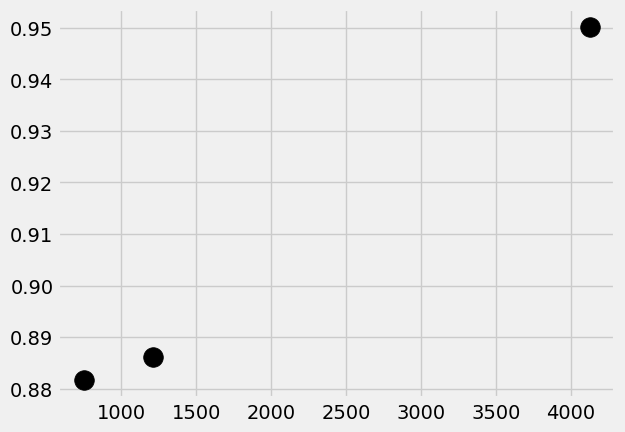

In [69]:
plt.scatter(centroids[:, 0], centroids[:, 1], c='black', s=200, alpha= 1)
plt.show()

### 9.2.1. Internal validation: 

#### 9.2.1.1. Silhouette Coefficient

In [70]:
silhouette_coefficients = []

for k in range(2, 11):
    Minikmeans = MiniBatchKMeans(n_clusters=k, init='random', n_init=10, max_iter=300, random_state=42)
    Minikmeans.fit(scaled_features)
    score = silhouette_score(scaled_features, Minikmeans.labels_)
    silhouette_coefficients.append(score)

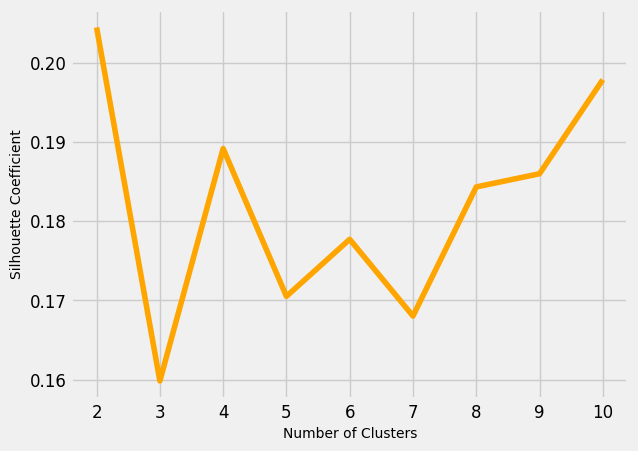

In [71]:
plt.style.use("fivethirtyeight")
plt.plot(range(2, 11), silhouette_coefficients, color= "orange")
plt.xticks(range(2, 11), fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel("Number of Clusters", fontsize=10)
plt.ylabel("Silhouette Coefficient" , fontsize=10)
plt.show()

#### Tuning hyperparameters

In [72]:
init =  ['k-means++', 'random']
n_init = [1 ,20]
nclusters = range(2,11)

silhouette_coefficients = []

# Iterate over all combinations of parameters
for i in init:
    for n in n_init:
        for k in nclusters:
            Minikmeans = MiniBatchKMeans(n_clusters=k, init=i, n_init=n, batch_size=1024, compute_labels=True, max_iter=300, random_state=42)
            Minikmeans.fit(scaled_features)
            
            # Calculate the silhouette score
            score = silhouette_score(scaled_features, Minikmeans.labels_)
            silhouette_coefficients.append((k, i, n, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_df = pd.DataFrame(silhouette_coefficients, columns=['n_clusters', 'init', 'n_init', 'silhouette_score'])
results_df

,n_clusters,init,n_init,silhouette_score
0,2,k-means++,1,0.335497
1,3,k-means++,1,0.208058
2,4,k-means++,1,0.197257
3,5,k-means++,1,0.197399
4,6,k-means++,1,0.160750
5,7,k-means++,1,0.195759
6,8,k-means++,1,0.197188
7,9,k-means++,1,0.179975
8,10,k-means++,1,0.163035
9,2,k-means++,20,0.213589


In [73]:
max_index = results_df['silhouette_score'].idxmax()
max_row = results_df.loc[max_index]
max_row

n_clusters                  2
init                k-means++
n_init                      1
silhouette_score     0.335497
Name: 0, dtype: object

In [74]:
results_df.style.highlight_max(color = 'red', axis = 0, subset= ['silhouette_score'])

,n_clusters,init,n_init,silhouette_score
0,2,k-means++,1,0.335497
1,3,k-means++,1,0.208058
2,4,k-means++,1,0.197257
3,5,k-means++,1,0.197399
4,6,k-means++,1,0.160750
5,7,k-means++,1,0.195759
6,8,k-means++,1,0.197188
7,9,k-means++,1,0.179975
8,10,k-means++,1,0.163035
9,2,k-means++,20,0.213589


In [75]:
max_value = results_df['silhouette_score'].max()
# Create a mask to extract all rows with the maximum value
max_rows_s = results_df[results_df['silhouette_score'] == max_value]
max_rows_s

,n_clusters,init,n_init,silhouette_score
0,2,k-means++,1,0.335497


#### 9.2.1.2. Calinski harabasz

#### Tuning hyperparameters

In [76]:
init =  ['k-means++', 'random']
n_init = [1 ,20]
nclusters = range(2,11)

calinski_harabasz = []

# Iterate over all combinations of parameters
for i in init:
    for n in n_init:
        for k in nclusters:
            Minikmeans = MiniBatchKMeans(n_clusters=k, init=i, n_init=n, max_iter=300, random_state=42)
            Minikmeans.fit(scaled_features)
            
            # Calculate the silhouette score
            score = calinski_harabasz_score(scaled_features, Minikmeans.labels_)
            calinski_harabasz.append((k, i, n, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_ch = pd.DataFrame(calinski_harabasz, columns=['n_clusters', 'init', 'n_init', 'calinski_harabasz'])
results_ch

,n_clusters,init,n_init,calinski_harabasz
0,2,k-means++,1,1282.938434
1,3,k-means++,1,1496.622319
2,4,k-means++,1,1529.507511
3,5,k-means++,1,1389.384094
4,6,k-means++,1,1230.671604
5,7,k-means++,1,1124.922863
6,8,k-means++,1,1097.721651
7,9,k-means++,1,1044.763402
8,10,k-means++,1,996.126051
9,2,k-means++,20,1638.978754


In [77]:
max_index = results_ch['calinski_harabasz'].idxmax()
max_row = results_ch.loc[max_index]
max_row

n_clusters                     2
init                      random
n_init                        20
calinski_harabasz    1647.603293
Name: 27, dtype: object

In [78]:
results_ch.style.highlight_max(color = 'red', axis = 0, subset= ['calinski_harabasz'])

,n_clusters,init,n_init,calinski_harabasz
0,2,k-means++,1,1282.938434
1,3,k-means++,1,1496.622319
2,4,k-means++,1,1529.507511
3,5,k-means++,1,1389.384094
4,6,k-means++,1,1230.671604
5,7,k-means++,1,1124.922863
6,8,k-means++,1,1097.721651
7,9,k-means++,1,1044.763402
8,10,k-means++,1,996.126051
9,2,k-means++,20,1638.978754


In [79]:
max_value = results_ch['calinski_harabasz'].max()
# Create a mask to extract all rows with the maximum value
max_rows_ch = results_ch[results_ch['calinski_harabasz'] == max_value]
max_rows_ch

,n_clusters,init,n_init,calinski_harabasz
27,2,random,20,1647.603293


#### 9.2.1.3. Davies Bouldin

In [80]:
Davies_Bouldin=[]

for k in range(2, 11):
    Minikmeans = MiniBatchKMeans(n_clusters = k, init='random', n_init=10, max_iter=300, random_state=42)
    Minikmeans.fit(scaled_features)
    score = davies_bouldin_score(scaled_features, Minikmeans.labels_)
    Davies_Bouldin.append(score)

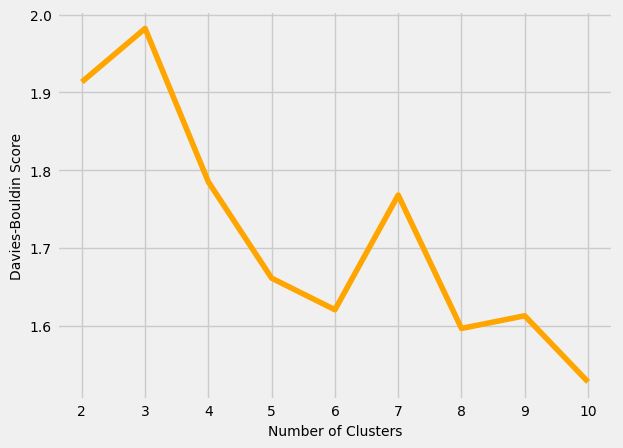

In [81]:
plt.style.use("fivethirtyeight")
plt.plot(range(2, 11), Davies_Bouldin, color="orange")
plt.xticks(range(2, 11), fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel("Number of Clusters", fontsize=10)
plt.ylabel("Davies-Bouldin Score", fontsize=10)
plt.show()

In [82]:
init =  ['k-means++', 'random']
n_init = [1 ,20]
nclusters = range(2,11)

Davies_Bouldin=[]

# Iterate over all combinations of parameters
for i in init:
    for n in n_init:
        for k in nclusters:
            Minikmeans = MiniBatchKMeans(n_clusters=k, init=i, n_init=n, max_iter=300, random_state=42)
            Minikmeans.fit(scaled_features)
            
            # Calculate the silhouette score
            score = davies_bouldin_score(scaled_features, Minikmeans.labels_)
            Davies_Bouldin.append((k, i, n, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_db = pd.DataFrame(Davies_Bouldin, columns=['n_clusters', 'init', 'n_init', 'davies_bouldin'])
results_db

,n_clusters,init,n_init,davies_bouldin
0,2,k-means++,1,1.987801
1,3,k-means++,1,1.647225
2,4,k-means++,1,1.586026
3,5,k-means++,1,1.503302
4,6,k-means++,1,1.661548
5,7,k-means++,1,1.778860
6,8,k-means++,1,1.667010
7,9,k-means++,1,1.630090
8,10,k-means++,1,1.670317
9,2,k-means++,20,1.910574


In [83]:
max_index = results_db['davies_bouldin'].idxmax()
max_row = results_db.loc[max_index]
max_row

n_clusters                2
init              k-means++
n_init                    1
davies_bouldin     1.987801
Name: 0, dtype: object

In [84]:
results_db.style.highlight_max(color = 'red', axis = 0, subset= ['davies_bouldin'])

,n_clusters,init,n_init,davies_bouldin
0,2,k-means++,1,1.987801
1,3,k-means++,1,1.647225
2,4,k-means++,1,1.586026
3,5,k-means++,1,1.503302
4,6,k-means++,1,1.661548
5,7,k-means++,1,1.778860
6,8,k-means++,1,1.667010
7,9,k-means++,1,1.630090
8,10,k-means++,1,1.670317
9,2,k-means++,20,1.910574


In [85]:
max_value = results_db['davies_bouldin'].max()
# Create a mask to extract all rows with the maximum value
max_rows_db = results_db[results_db['davies_bouldin'] == max_value]
max_rows_db

,n_clusters,init,n_init,davies_bouldin
0,2,k-means++,1,1.987801


### 9.2.2. Final Results from MiniBatchKMeans

In [86]:
table = pd.concat([max_rows_s, max_rows_ch, max_rows_db], ignore_index=True)
table = table.fillna("-")
table

,n_clusters,init,n_init,silhouette_score,calinski_harabasz,davies_bouldin
0,2,k-means++,1,0.335497,-,-
1,2,random,20,-,1647.603293,-
2,2,k-means++,1,-,-,1.987801


### 9.2.3. Substituting the optimal parameters in MiniBatchKMeans and Prediction

In [87]:
Minikmeans = MiniBatchKMeans(n_clusters=2, init="random", n_init=20, max_iter=300, random_state=42)
Minikmeans.fit(scaled_features)
predictMBK=Minikmeans.predict(scaled_features)

In [88]:
print("silhouette_score:", silhouette_score(scaled_features,Minikmeans.labels_))
print("calinski_harabasz:", calinski_harabasz_score(scaled_features,Minikmeans.labels_))
print("davies_bouldin:", davies_bouldin_score(scaled_features,Minikmeans.labels_))   

silhouette_score: 0.20697005762391305
calinski_harabasz: 1647.6032933334975
davies_bouldin: 1.9124322449798279


### 9.2.4. Add MiniBatchKMeans Prediction to dataset

In [89]:
df3['MiniBatchKMeans'] = predictMBK
df3

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,K_mean Prediction,MiniBatchKMeans
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,1,1
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1,1
5,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8943,5.871712,0.500000,20.90,20.90,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,1,500.0,58.644883,43.473717,0.000000,6,1,1
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0,0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,1,1
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,1,1


## 9.3. MeanShift

In [90]:
best_bandwidth = None
max_clusters = 0
min_clusters = float('inf')  # Initialize to a large value

for bw in range(1, 10):            
            ms = MeanShift(bandwidth=bw, bin_seeding=True)
            ms.fit(scaled_features)
            labels = ms.labels_
            labels_unique = np.unique(labels)
            n_clusters_ = len(labels_unique)
            
            print("Bandwidth:", bw, " -> Estimated number of clusters: %d" % n_clusters_)
            
            # Track the best bandwidth with the highest number of clusters
            if n_clusters_ > max_clusters:
                max_clusters = n_clusters_
                best_bandwidth = bw
                
            # Track the minimum number of clusters
            if n_clusters_ < min_clusters:
                min_clusters = n_clusters_
                Minbandwidth = bw  # Update the bandwidth for minimum clusters
    
print("\nBest bandwidth:", best_bandwidth, "with", max_clusters, "clusters")
print("Minimum bandwidth:", Minbandwidth, "with", min_clusters, "clusters")

Bandwidth: 1  -> Estimated number of clusters: 17
Bandwidth: 2  -> Estimated number of clusters: 101
Bandwidth: 3  -> Estimated number of clusters: 64
Bandwidth: 4  -> Estimated number of clusters: 44
Bandwidth: 5  -> Estimated number of clusters: 24
Bandwidth: 6  -> Estimated number of clusters: 20
Bandwidth: 7  -> Estimated number of clusters: 17
Bandwidth: 8  -> Estimated number of clusters: 15
Bandwidth: 9  -> Estimated number of clusters: 9

Best bandwidth: 2 with 101 clusters
Minimum bandwidth: 9 with 9 clusters


In [91]:
ms = MeanShift(bandwidth=9).fit(df2)
centroids = ms.cluster_centers_
print(centroids)

[[1.90431386e+04 1.00000000e+00 2.20099200e+04 ... 1.20000000e+01
  0.00000000e+00 0.00000000e+00]
 [1.84955586e+04 1.00000000e+00 5.28828000e+03 ... 1.20000000e+01
  0.00000000e+00 0.00000000e+00]
 [1.63048893e+04 1.00000000e+00 1.77057000e+03 ... 1.20000000e+01
  1.00000000e+00 1.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 2.78000000e+02 ... 1.20000000e+01
  1.00000000e+00 1.00000000e+00]
 [0.00000000e+00 0.00000000e+00 2.65760000e+02 ... 1.20000000e+01
  1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 3.09800000e+01 ... 1.20000000e+01
  1.00000000e+00 1.00000000e+00]]


### 9.3.1. Internal validation

#### 9.3.1.1. Silhouette coefficient

In [92]:

silhouette_coefficients = []

for bw in range(1, 15):            
            ms = MeanShift(bandwidth=bw, bin_seeding=True)
            ms.fit(scaled_features)
    
            # Calculate the silhouette score
            score = silhouette_score(scaled_features, ms.labels_)
            silhouette_coefficients.append((bw, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_df = pd.DataFrame(silhouette_coefficients, columns=['n_bandwidth', 'silhouette coefficients'])
results_df

,n_bandwidth,silhouette coefficients
0,1,0.073104
1,2,0.178479
2,3,0.180003
3,4,0.287303
4,5,0.510187
5,6,0.543471
6,7,0.627232
7,8,0.636506
8,9,0.707850
9,10,0.714991


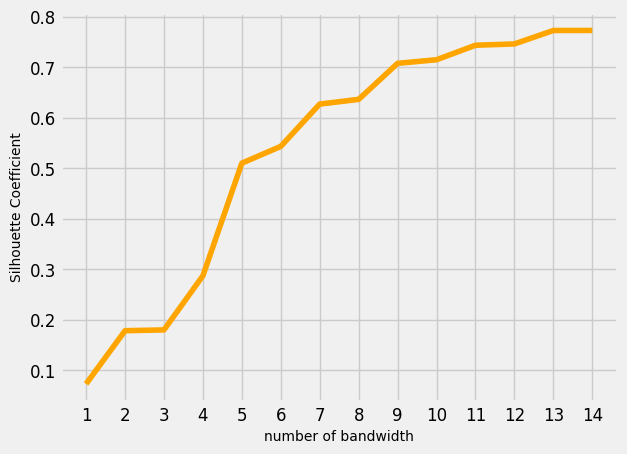

In [93]:

plt.plot(range(1, 15), results_df["silhouette coefficients"], color= "orange")
plt.xticks(range(1, 15), fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel("number of bandwidth", fontsize=10)
plt.ylabel("Silhouette Coefficient" , fontsize=10)
plt.show()

In [94]:
max_index = results_df['silhouette coefficients'].idxmax()
max_row = results_df.loc[max_index]
max_row

n_bandwidth                13.000000
silhouette coefficients     0.772976
Name: 12, dtype: float64

In [95]:
results_df.style.highlight_max(color = 'orange', axis = 0, subset= ['silhouette coefficients'])

,n_bandwidth,silhouette coefficients
0,1,0.073104
1,2,0.178479
2,3,0.180003
3,4,0.287303
4,5,0.510187
5,6,0.543471
6,7,0.627232
7,8,0.636506
8,9,0.707850
9,10,0.714991


In [96]:
max_value = results_df['silhouette coefficients'].max()
# Create a mask to extract all rows with the maximum value
max_rows_s = results_df[results_df['silhouette coefficients'] == max_value]
max_rows_s

,n_bandwidth,silhouette coefficients
12,13,0.772976
13,14,0.772976


#### 9.3.1.2. Calinski harabasz

In [97]:

calinski_harabasz=[]

for bw in range(1, 15):            
            ms = MeanShift(bandwidth=bw, bin_seeding=True)
            ms.fit(scaled_features)
    
            # Calculate the silhouette score
            score = calinski_harabasz_score(scaled_features, ms.labels_)
            calinski_harabasz.append((bw, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_ch = pd.DataFrame(calinski_harabasz, columns=['n_bandwidth', 'calinski_harabasz'])
results_ch

,n_bandwidth,calinski_harabasz
0,1,480.001293
1,2,230.143690
2,3,97.682385
3,4,110.625712
4,5,122.980196
5,6,125.356866
6,7,113.574039
7,8,121.925156
8,9,174.431417
9,10,187.005096


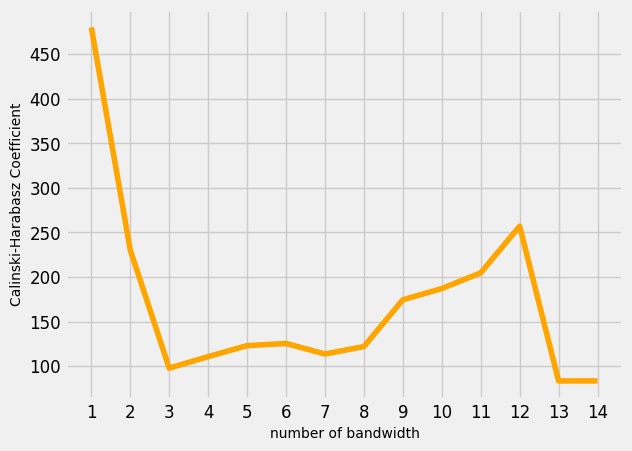

In [98]:

plt.plot(range(1, 15), results_ch["calinski_harabasz"], color= "orange")
plt.xticks(range(1, 15), fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel("number of bandwidth", fontsize=10)
plt.ylabel("Calinski-Harabasz Coefficient" , fontsize=10)
plt.show()

In [99]:
max_index = results_ch['calinski_harabasz'].idxmax()
max_row = results_ch.loc[max_index]
max_row

n_bandwidth            1.000000
calinski_harabasz    480.001293
Name: 0, dtype: float64

In [100]:
results_ch.style.highlight_max(color = 'orange', axis = 0, subset= ['calinski_harabasz'])

,n_bandwidth,calinski_harabasz
0,1,480.001293
1,2,230.143690
2,3,97.682385
3,4,110.625712
4,5,122.980196
5,6,125.356866
6,7,113.574039
7,8,121.925156
8,9,174.431417
9,10,187.005096


In [101]:
max_value = results_ch['calinski_harabasz'].max()
# Create a mask to extract all rows with the maximum value
max_rows_c = results_ch[results_ch['calinski_harabasz'] == max_value]
max_rows_c

,n_bandwidth,calinski_harabasz
0,1,480.001293


#### 9.3.1.3.  Davies Bouldin

In [102]:

davies_bouldin=[]

for bw in range(1, 15):            
            ms = MeanShift(bandwidth=bw, bin_seeding=True)
            ms.fit(scaled_features)
    
            # Calculate the silhouette score
            score = davies_bouldin_score(scaled_features, ms.labels_)
            davies_bouldin.append((bw, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_db = pd.DataFrame(davies_bouldin, columns=['n_bandwidth', 'Davies_Bouldin'])
results_db

,n_bandwidth,Davies_Bouldin
0,1,1.999049
1,2,1.703333
2,3,1.374899
3,4,1.132077
4,5,1.009545
5,6,0.946091
6,7,0.828050
7,8,0.881648
8,9,1.075888
9,10,1.064559


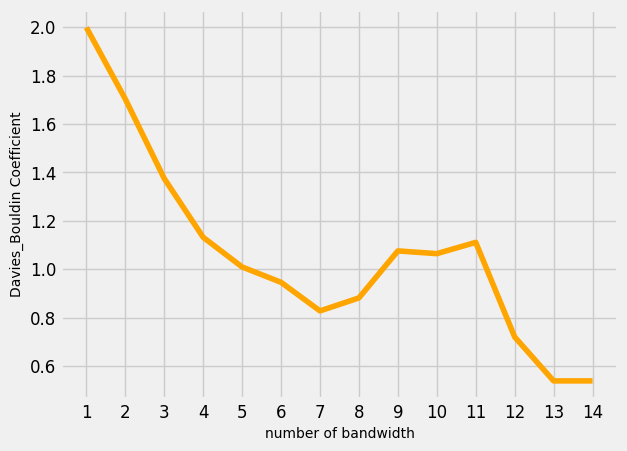

In [103]:

plt.plot(range(1, 15), results_db["Davies_Bouldin"], color= "orange")
plt.xticks(range(1, 15), fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel("number of bandwidth", fontsize=10)
plt.ylabel("Davies_Bouldin Coefficient" , fontsize=10)
plt.show()

In [104]:
max_index = results_db['Davies_Bouldin'].idxmax()
max_row = results_db.loc[max_index]
max_row

n_bandwidth       1.000000
Davies_Bouldin    1.999049
Name: 0, dtype: float64

In [105]:
results_db.style.highlight_max(color = 'orange', axis = 0, subset= ['Davies_Bouldin'])

,n_bandwidth,Davies_Bouldin
0,1,1.999049
1,2,1.703333
2,3,1.374899
3,4,1.132077
4,5,1.009545
5,6,0.946091
6,7,0.828050
7,8,0.881648
8,9,1.075888
9,10,1.064559


In [106]:
max_value = results_db['Davies_Bouldin'].max()
# Create a mask to extract all rows with the maximum value
max_rows_d = results_db[results_db['Davies_Bouldin'] == max_value]
max_rows_d

,n_bandwidth,Davies_Bouldin
0,1,1.999049


### 9.3.2. Final Results from MeanShift

In [107]:
table = pd.concat([max_rows_s, max_rows_c, max_rows_d], ignore_index=True)
table = table.fillna("-")
table

,n_bandwidth,silhouette coefficients,calinski_harabasz,Davies_Bouldin
0,13,0.772976,-,-
1,14,0.772976,-,-
2,1,-,480.001293,-
3,1,-,-,1.999049


### 9.3.3. Substituting the optimal parameter in MeanShift and Prediction

In [108]:
ms = MeanShift(bandwidth=13, bin_seeding=True, max_iter=300)
ms.fit(scaled_features)
predict_ms=ms.predict(scaled_features)

In [109]:
print("silhouette_score:", silhouette_score(scaled_features,ms.labels_))
print("calinski_harabasz:", calinski_harabasz_score(scaled_features,ms.labels_))
print("davies_bouldin:", davies_bouldin_score(scaled_features,ms.labels_))   

silhouette_score: 0.7729757576942968
calinski_harabasz: 83.36712561107467
davies_bouldin: 0.5387625058444767


### 9.3.4. Add MeanShift Prediction to dataset

In [110]:
df3['MeanShift Prediction'] = predict_ms
df3

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,K_mean Prediction,MiniBatchKMeans,MeanShift Prediction
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,1,1,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1,1,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0,0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1,1,0
5,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8943,5.871712,0.500000,20.90,20.90,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,1,500.0,58.644883,43.473717,0.000000,6,1,1,0
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0,0,0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,1,1,0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,1,1,0


## 9.4. DBSCAN

### 9.4.1. Internal validation: 

#### 9.4.1.1. Silhouette coefficient

In [111]:
silhouette_coefficients = []
eps_values = []

for eps in range(1, 15):
    print(f"Running DBSCAN with eps = {eps}") # Check eps values
    db = DBSCAN(eps=eps)
    db.fit(scaled_features)
    
    # Check if only one cluster or all noise before calculating score
    if len(np.unique(db.labels_)) > 1:  # Check for more than one label
        score = silhouette_score(scaled_features, db.labels_)
        silhouette_coefficients.append(score)
        eps_values.append(eps)
    else:
        # Handle the case of only one cluster or all noise (optional)
        silhouette_coefficients.append(np.nan)  # or some other placeholder

Running DBSCAN with eps = 1
Running DBSCAN with eps = 2
Running DBSCAN with eps = 3
Running DBSCAN with eps = 4
Running DBSCAN with eps = 5
Running DBSCAN with eps = 6
Running DBSCAN with eps = 7
Running DBSCAN with eps = 8
Running DBSCAN with eps = 9
Running DBSCAN with eps = 10
Running DBSCAN with eps = 11
Running DBSCAN with eps = 12
Running DBSCAN with eps = 13
Running DBSCAN with eps = 14


In [112]:
silhouette_coeff = pd.DataFrame({
    "eps": eps_values, 
    "silhouette_coefficients": silhouette_coefficients
})

silhouette_coeff

,eps,silhouette_coefficients
0,1,-0.261413
1,2,0.389836
2,3,0.623327
3,4,0.700390
4,5,0.708630
5,6,0.752163
6,7,0.800607
7,8,0.808237
8,9,0.827657
9,10,0.833346


In [113]:
silhouette_coefficients = []
 
for eps in range(1, 15):
    
    db = DBSCAN(eps=eps)
    db.fit(scaled_features)
    score = silhouette_score(scaled_features, db.labels_)
    silhouette_coefficients.append(score)

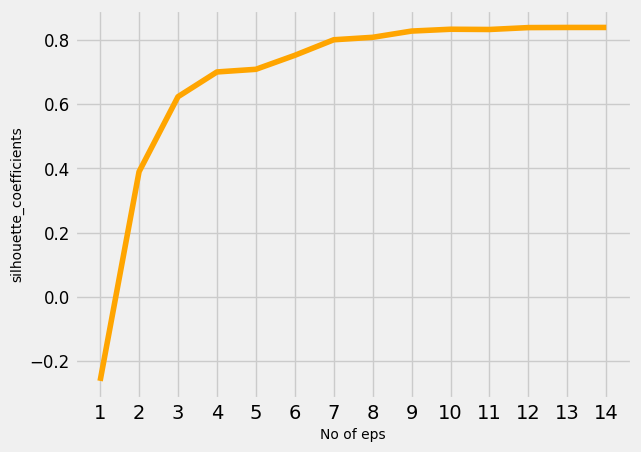

In [114]:
plt.style.use('fivethirtyeight')
plt.plot(range(1,15), silhouette_coefficients , color= "orange")
plt.xticks(range(1,15))
plt.yticks(fontsize=12)
plt.xlabel('No of eps' , fontsize=10)
plt.ylabel('silhouette_coefficients' , fontsize=10)
plt.show()

#### Tuning hyperparameters

In [115]:
eps = range(1, 11)
min_samples =  range(1,11)
algorithm=['auto','ball_tree','kd_tree','brute']


silhouette_coefficients = []

# Iterate over all combinations of parameters
for e in eps:
    for m in min_samples:
        for a in algorithm:
            
            db = DBSCAN(eps=e, min_samples=m, algorithm=a)
            db.fit(scaled_features)
            
            # Calculate the silhouette score
            score = silhouette_score(scaled_features, db.labels_)
            silhouette_coefficients.append((e, m, a, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
import pandas as pd
results_df = pd.DataFrame(silhouette_coefficients, columns=['eps', 'min_samples', 'algorithm', 'silhouette_coefficients'])
results_df

,eps,min_samples,algorithm,silhouette_coefficients
0,1,1,auto,-0.379408
1,1,1,ball_tree,-0.379408
2,1,1,kd_tree,-0.379408
3,1,1,brute,-0.379408
4,1,2,auto,-0.464222
...,...,...,...,...
395,10,9,brute,0.829690
396,10,10,auto,0.829690
397,10,10,ball_tree,0.829690
398,10,10,kd_tree,0.829690


In [116]:
max_index = results_df['silhouette_coefficients'].idxmax()
max_row = results_df.loc[max_index]
max_row

eps                              10
min_samples                       4
algorithm                      auto
silhouette_coefficients    0.833346
Name: 372, dtype: object

In [117]:
results_df.style.highlight_max(color = 'orange', axis = 0, subset= ['silhouette_coefficients'])

,eps,min_samples,algorithm,silhouette_coefficients
0,1,1,auto,-0.379408
1,1,1,ball_tree,-0.379408
2,1,1,kd_tree,-0.379408
3,1,1,brute,-0.379408
4,1,2,auto,-0.464222
5,1,2,ball_tree,-0.464222
6,1,2,kd_tree,-0.464222
7,1,2,brute,-0.464222
8,1,3,auto,-0.423325
9,1,3,ball_tree,-0.423325


In [118]:
max_value = results_df['silhouette_coefficients'].max()
# Create a mask to extract all rows with the maximum value
max_rows_s = results_df[results_df['silhouette_coefficients'] == max_value]
max_rows_s

,eps,min_samples,algorithm,silhouette_coefficients
372,10,4,auto,0.833346
373,10,4,ball_tree,0.833346
374,10,4,kd_tree,0.833346
375,10,4,brute,0.833346
376,10,5,auto,0.833346
377,10,5,ball_tree,0.833346
378,10,5,kd_tree,0.833346
379,10,5,brute,0.833346
380,10,6,auto,0.833346
381,10,6,ball_tree,0.833346


#### 9.4.1.2. Calinski harabasz

In [119]:
calinski_harabasz=[]

for eps in range(1,15):
    db=DBSCAN(eps=eps)
    db.fit(scaled_features)
    score=calinski_harabasz_score(scaled_features,db.labels_)
    calinski_harabasz.append(score)

In [120]:
output = pd.DataFrame({
    "eps": eps,
    "calinski_harabasz": calinski_harabasz
})

output = output.fillna("-")
output

,eps,calinski_harabasz
0,14,50.801229
1,14,462.913448
2,14,840.791505
3,14,705.860530
4,14,394.599424
5,14,349.781946
6,14,471.871835
7,14,441.660838
8,14,275.313453
9,14,266.734304


In [121]:
calinski_harabasz = []

for i in range(1, 15):
    db = DBSCAN(eps=i)
    db.fit(scaled_features)
    
    # Check if there are at least two clusters
    unique_labels = np.unique(db.labels_)
    if len(unique_labels) > 1:
        score = calinski_harabasz_score(scaled_features, db.labels_)
    else:
        # Append NaN to indicate that no valid score could be calculated
        score = np.nan
    calinski_harabasz.append(score)

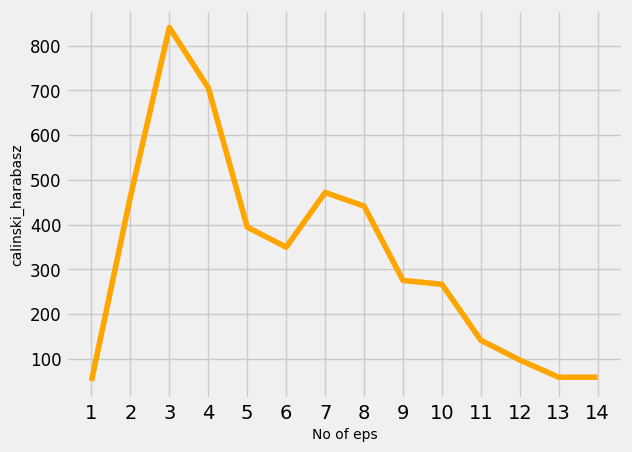

In [122]:
plt.style.use('fivethirtyeight')
plt.plot(range(1,15), calinski_harabasz , color= "orange")
plt.xticks(range(1,15))
plt.yticks(fontsize=12)
plt.xlabel('No of eps' , fontsize=10)
plt.ylabel('calinski_harabasz' , fontsize=10)
plt.show()

#### Tuning hyperparameters

In [123]:
eps = range(1, 11)
min_samples =  range(1,11)
algorithm=['auto','ball_tree','kd_tree','brute']


calinski_harabasz=[]

# Iterate over all combinations of parameters
for e in eps:
    for m in min_samples:
        for a in algorithm:
            
            db = DBSCAN(eps=e, min_samples=m, algorithm=a)
            db.fit(scaled_features)
            
            # Calculate the calinski_harabasz score
            score = calinski_harabasz_score(scaled_features, db.labels_)
            calinski_harabasz.append((e, m, a, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_ch = pd.DataFrame(calinski_harabasz, columns=['eps', 'min_samples', 'algorithm', 'calinski_harabasz'])
results_ch

,eps,min_samples,algorithm,calinski_harabasz
0,1,1,auto,5.366241
1,1,1,ball_tree,5.366241
2,1,1,kd_tree,5.366241
3,1,1,brute,5.366241
4,1,2,auto,7.770289
...,...,...,...,...
395,10,9,brute,291.983779
396,10,10,auto,291.983779
397,10,10,ball_tree,291.983779
398,10,10,kd_tree,291.983779


In [124]:
max_index = results_ch['calinski_harabasz'].idxmax()
max_row = results_ch.loc[max_index]
max_row

eps                           2
min_samples                  10
algorithm                  auto
calinski_harabasz    945.131499
Name: 76, dtype: object

In [125]:
results_ch.style.highlight_max(color = 'orange', axis = 0, subset= ['calinski_harabasz'])

,eps,min_samples,algorithm,calinski_harabasz
0,1,1,auto,5.366241
1,1,1,ball_tree,5.366241
2,1,1,kd_tree,5.366241
3,1,1,brute,5.366241
4,1,2,auto,7.770289
5,1,2,ball_tree,7.770289
6,1,2,kd_tree,7.770289
7,1,2,brute,7.770289
8,1,3,auto,17.780600
9,1,3,ball_tree,17.780600


In [126]:
max_value = results_ch['calinski_harabasz'].max()
# Create a mask to extract all rows with the maximum value
max_rows_ch = results_ch[results_ch['calinski_harabasz'] == max_value]
max_rows_ch

,eps,min_samples,algorithm,calinski_harabasz
76,2,10,auto,945.131499
77,2,10,ball_tree,945.131499
78,2,10,kd_tree,945.131499
79,2,10,brute,945.131499


#### 9.4.1.3. Davies Bouldin

In [127]:
Davies_Bouldin=[]
 
for eps in range(1, 15):
    
    db = DBSCAN(eps=eps)
    db.fit(scaled_features)
    score = davies_bouldin_score(scaled_features, db.labels_)
    Davies_Bouldin.append(score)

In [128]:
output = pd.DataFrame({
    "eps": eps,
    "Davies_Bouldin": Davies_Bouldin
})

output

,eps,Davies_Bouldin
0,14,1.518667
1,14,1.994413
2,14,1.669011
3,14,1.534210
4,14,1.129773
5,14,1.798271
6,14,1.189818
7,14,1.031687
8,14,1.097391
9,14,1.069573


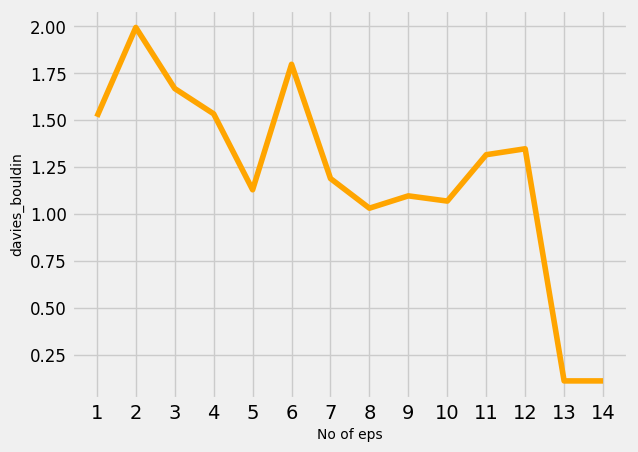

In [129]:
plt.style.use('fivethirtyeight')
plt.plot(range(1,15), Davies_Bouldin , color= "orange")
plt.xticks(range(1,15))
plt.yticks(fontsize=12)
plt.xlabel('No of eps' , fontsize=10)
plt.ylabel('davies_bouldin' , fontsize=10)
plt.show()

In [130]:
eps = range(1, 15)
min_samples =  range(1,15)
algorithm=['auto','ball_tree','kd_tree','brute']


Davies_Bouldin=[]

# Iterate over all combinations of parameters
for e in eps:
    for m in min_samples:
        for a in algorithm:
            
            db = DBSCAN(eps=e, min_samples=m, algorithm=a)
            db.fit(scaled_features)
            
            # Calculate the Davies_Bouldin score
            score = davies_bouldin_score(scaled_features, db.labels_)
            Davies_Bouldin.append((e, m, a, score))  # Store the score with parameter values

# Convert to a structured format for easier analysis (e.g., DataFrame)
results_db = pd.DataFrame(Davies_Bouldin, columns=['eps', 'min_samples', 'algorithm', 'Davies_Bouldin'])
results_db

,eps,min_samples,algorithm,Davies_Bouldin
0,1,1,auto,0.617329
1,1,1,ball_tree,0.617329
2,1,1,kd_tree,0.617329
3,1,1,brute,0.617329
4,1,2,auto,1.419887
...,...,...,...,...
779,14,13,brute,0.965401
780,14,14,auto,0.965401
781,14,14,ball_tree,0.965401
782,14,14,kd_tree,0.965401


In [131]:
max_index = results_db['Davies_Bouldin'].idxmax()
max_row = results_db.loc[max_index]
max_row

eps                      1
min_samples             13
algorithm             auto
Davies_Bouldin    2.328227
Name: 48, dtype: object

In [132]:
results_db.style.highlight_max(color = 'red', axis = 0, subset= ['Davies_Bouldin'])

,eps,min_samples,algorithm,Davies_Bouldin
0,1,1,auto,0.617329
1,1,1,ball_tree,0.617329
2,1,1,kd_tree,0.617329
3,1,1,brute,0.617329
4,1,2,auto,1.419887
5,1,2,ball_tree,1.419887
6,1,2,kd_tree,1.419887
7,1,2,brute,1.419887
8,1,3,auto,1.509464
9,1,3,ball_tree,1.509464


In [133]:
max_value = results_db['Davies_Bouldin'].max()
# Create a mask to extract all rows with the maximum value
max_rows_db = results_db[results_db['Davies_Bouldin'] == max_value]
max_rows_db

,eps,min_samples,algorithm,Davies_Bouldin
48,1,13,auto,2.328227
49,1,13,ball_tree,2.328227
50,1,13,kd_tree,2.328227
51,1,13,brute,2.328227


### 9.4.2. Final Results from DBSCAN

In [134]:
table = pd.concat([max_rows_s, max_rows_ch, max_rows_db], ignore_index=True)
table = table.fillna("-")
table

,eps,min_samples,algorithm,silhouette_coefficients,calinski_harabasz,Davies_Bouldin
0,10,4,auto,0.833346,-,-
1,10,4,ball_tree,0.833346,-,-
2,10,4,kd_tree,0.833346,-,-
3,10,4,brute,0.833346,-,-
4,10,5,auto,0.833346,-,-
5,10,5,ball_tree,0.833346,-,-
6,10,5,kd_tree,0.833346,-,-
7,10,5,brute,0.833346,-,-
8,10,6,auto,0.833346,-,-
9,10,6,ball_tree,0.833346,-,-


### 9.4.3. Substituting the optimal parameters in DBSCAN and Prediction

#### Point: 
The DBSCAN class in scikit-learn doesn’t have a predict method. Unlike other clustering algorithms like KMeans, DBSCAN doesn’t naturally support predicting the cluster of a new data point, as it’s a density-based clustering method and works differently.

In [135]:
dbscan = DBSCAN(eps=2, min_samples=10, algorithm= "auto")
dbscan.fit(scaled_features)
labels = dbscan.labels_
labels

array([0, 0, 0, ..., 0, 0, 0])

In [136]:
labels = dbscan.labels_
labels_df = pd.DataFrame({"label": labels})
labels_df

,label
0,0
1,0
2,0
3,0
4,0
...,...
8631,0
8632,0
8633,0
8634,0


In [137]:
count_labels_greater_than_zero = (labels > 0).sum()
print("Number of labels greater than 0:", count_labels_greater_than_zero)

Number of labels greater than 0: 0


In [138]:
print("silhouette_score:", silhouette_score(scaled_features,dbscan.labels_))
print("calinski_harabasz:", calinski_harabasz_score(scaled_features,dbscan.labels_))
print("davies_bouldin:", davies_bouldin_score(scaled_features,dbscan.labels_))   

silhouette_score: 0.4592273481385482
calinski_harabasz: 945.1314989631097
davies_bouldin: 2.157177741968084


In [139]:
predict_db=dbscan.fit_predict(scaled_features)

### 9.4.4. Add DBSCAN Prediction to dataset

In [140]:
df3['DBSCAN'] = predict_db
df3

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,...,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,K_mean Prediction,MiniBatchKMeans,MeanShift Prediction,DBSCAN
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,...,2,1000.0,201.802084,139.509787,0.000000,12,1,1,0,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,...,0,7000.0,4103.032597,1072.340217,0.222222,12,1,1,0,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,...,12,7500.0,622.066742,627.284787,0.000000,12,0,0,0,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,...,1,1200.0,678.334763,244.791237,0.000000,12,1,1,0,0
5,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,...,8,1800.0,1400.057770,2407.246035,0.000000,12,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8943,5.871712,0.500000,20.90,20.90,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,...,1,500.0,58.644883,43.473717,0.000000,6,1,1,0,0
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,...,6,1000.0,325.594462,48.886365,0.500000,6,0,0,0,0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,...,5,1000.0,81.270775,82.418369,0.250000,6,1,1,0,0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,...,0,500.0,52.549959,55.755628,0.250000,6,1,1,0,0


# 10. Final results comparison from 4 models

In [141]:
df3[["K_mean Prediction", "MiniBatchKMeans", "MeanShift Prediction", "DBSCAN"]]

,K_mean Prediction,MiniBatchKMeans,MeanShift Prediction,DBSCAN
0,1,1,0,0
1,1,1,0,0
2,0,0,0,0
4,1,1,0,0
5,0,0,0,0
...,...,...,...,...
8943,1,1,0,0
8945,0,0,0,0
8947,1,1,0,0
8948,1,1,0,0
